<a href="https://colab.research.google.com/github/jaivanti/syracuse/blob/main/SuperResolutionSubPixel.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf

import os
import math
import numpy as np

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import array_to_img
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing import image_dataset_from_directory

from IPython.display import display

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
root_dir = '/content/drive/MyDrive/tiny'

In [4]:
crop_size = 300
upscale_factor = 3
input_size = crop_size // upscale_factor
batch_size = 8

train_ds = image_dataset_from_directory(
    root_dir,
    batch_size=batch_size,
    image_size=(crop_size, crop_size),
    validation_split=0.2,
    subset="training",
    seed=1337,
    label_mode=None,
)

valid_ds = image_dataset_from_directory(
    root_dir,
    batch_size=batch_size,
    image_size=(crop_size, crop_size),
    validation_split=0.2,
    subset="validation",
    seed=1337,
    label_mode=None,
)

Found 1780 files belonging to 1 classes.
Using 1424 files for training.
Found 1780 files belonging to 1 classes.
Using 356 files for validation.


In [5]:

def scaling(input_image):
    input_image = input_image / 255.0
    return input_image


# Scale from (0, 255) to (0, 1)
train_ds = train_ds.map(scaling)
valid_ds = valid_ds.map(scaling)

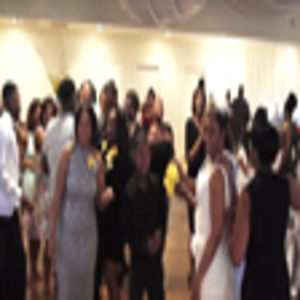

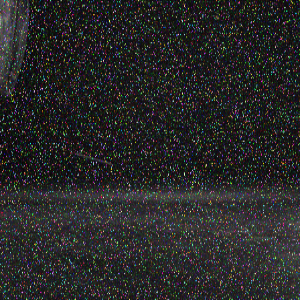

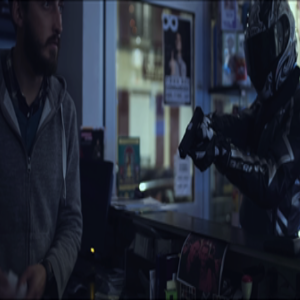

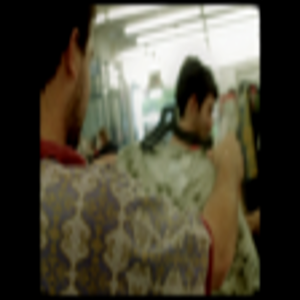

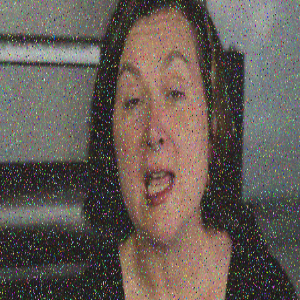

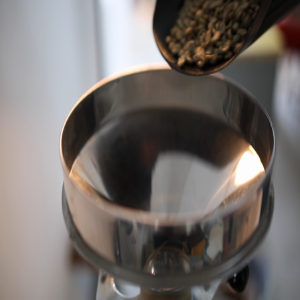

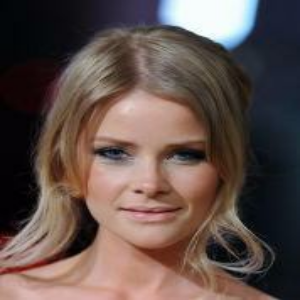

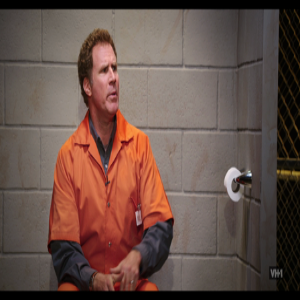

In [6]:
for batch in train_ds.take(1):
    for img in batch:
        display(array_to_img(img))

In [7]:
train_ds

<MapDataset shapes: (None, 300, 300, 3), types: tf.float32>

In [8]:
dataset = os.path.join(root_dir, "images")
test_path = os.path.join(dataset, "test")
#test_path_f = os.path.join(test_path, ) 

test_img_paths = sorted(
    [
        os.path.join(test_path, fname)
        for fname in os.listdir(test_path)
        if fname.endswith(".png")
    ]
)

In [9]:
len(test_img_paths)

56

In [10]:
root_dir

'/content/drive/MyDrive/tiny'

In [11]:
test_path

'/content/drive/MyDrive/tiny/images/test'

In [12]:
train_ds

<MapDataset shapes: (None, 300, 300, 3), types: tf.float32>

In [13]:
valid_ds  

<MapDataset shapes: (None, 300, 300, 3), types: tf.float32>

In [14]:

# Use TF Ops to process.
def process_input(input, input_size, upscale_factor):
    input = tf.image.rgb_to_yuv(input)
    last_dimension_axis = len(input.shape) - 1
    y, u, v = tf.split(input, 3, axis=last_dimension_axis)
    return tf.image.resize(y, [input_size, input_size], method="area")


def process_target(input):
    input = tf.image.rgb_to_yuv(input)
    last_dimension_axis = len(input.shape) - 1
    y, u, v = tf.split(input, 3, axis=last_dimension_axis)
    return y


In [15]:

train_ds = train_ds.map(
    lambda x: (process_input(x, input_size, upscale_factor), process_target(x))
)
train_ds = train_ds.prefetch(buffer_size=32)

valid_ds = valid_ds.map(
    lambda x: (process_input(x, input_size, upscale_factor), process_target(x))
)
valid_ds = valid_ds.prefetch(buffer_size=32)

In [16]:
train_ds

<PrefetchDataset shapes: ((None, 100, 100, 1), (None, 300, 300, 1)), types: (tf.float32, tf.float32)>

In [17]:
valid_ds

<PrefetchDataset shapes: ((None, 100, 100, 1), (None, 300, 300, 1)), types: (tf.float32, tf.float32)>

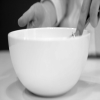

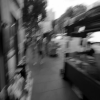

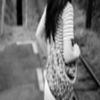

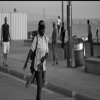

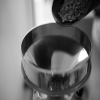

...

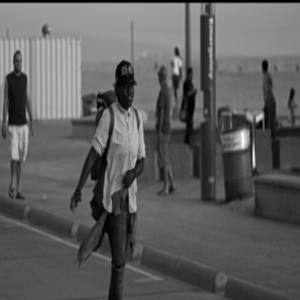

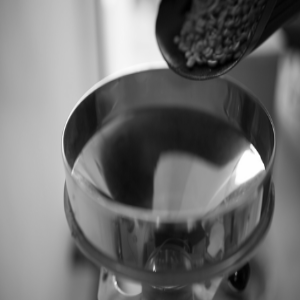

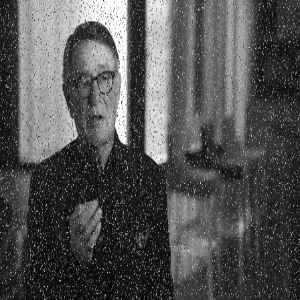

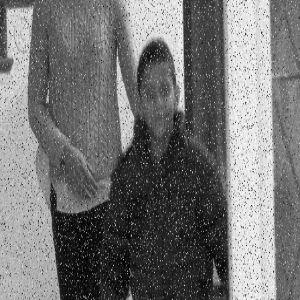

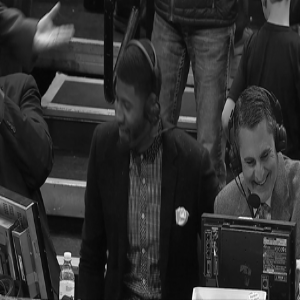

In [18]:
for batch in train_ds.take(1):
    for img in batch[0]:
        display(array_to_img(img))
    for img in batch[1]:
        display(array_to_img(img))

In [19]:

def get_model(upscale_factor=3, channels=1):
    conv_args = {
        "activation": "relu",
        "kernel_initializer": "Orthogonal",
        "padding": "same",
    }
    inputs = keras.Input(shape=(None, None, channels))
    x = layers.Conv2D(64, 5, **conv_args)(inputs)
    x = layers.Conv2D(64, 3, **conv_args)(x)
    x = layers.Conv2D(32, 3, **conv_args)(x)
    x = layers.Conv2D(channels * (upscale_factor ** 2), 3, **conv_args)(x)
    outputs = tf.nn.depth_to_space(x, upscale_factor)
    print("w")
    return keras.Model(inputs, outputs)


In [20]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
import PIL


def plot_results(img, prefix, title):
    """Plot the result with zoom-in area."""
    img_array = img_to_array(img)
    img_array = img_array.astype("float32") / 255.0

    # Create a new figure with a default 111 subplot.
    fig, ax = plt.subplots()
    im = ax.imshow(img_array[::-1], origin="lower")

    plt.title(title)
    # zoom-factor: 2.0, location: upper-left
    axins = zoomed_inset_axes(ax, 2, loc=2)
    axins.imshow(img_array[::-1], origin="lower")

    # Specify the limits.
    x1, x2, y1, y2 = 200, 300, 100, 200
    # Apply the x-limits.
    axins.set_xlim(x1, x2)
    # Apply the y-limits.
    axins.set_ylim(y1, y2)

    plt.yticks(visible=False)
    plt.xticks(visible=False)

    # Make the line.
    mark_inset(ax, axins, loc1=1, loc2=3, fc="none", ec="blue")
    plt.savefig(str(prefix) + "-" + title + ".png")
    plt.show()


def get_lowres_image(img, upscale_factor):
    """Return low-resolution image to use as model input."""
    return img.resize(
        (img.size[0] // upscale_factor, img.size[1] // upscale_factor),
        PIL.Image.BICUBIC,
    )


def upscale_image(model, img):
    """Predict the result based on input image and restore the image as RGB."""
    ycbcr = img.convert("YCbCr")
    y, cb, cr = ycbcr.split()
    y = img_to_array(y)
    y = y.astype("float32") / 255.0

    input = np.expand_dims(y, axis=0)
    out = model.predict(input)

    out_img_y = out[0]
    out_img_y *= 255.0

    # Restore the image in RGB color space.
    out_img_y = out_img_y.clip(0, 255)
    out_img_y = out_img_y.reshape((np.shape(out_img_y)[0], np.shape(out_img_y)[1]))
    out_img_y = PIL.Image.fromarray(np.uint8(out_img_y), mode="L")
    out_img_cb = cb.resize(out_img_y.size, PIL.Image.BICUBIC)
    out_img_cr = cr.resize(out_img_y.size, PIL.Image.BICUBIC)
    out_img = PIL.Image.merge("YCbCr", (out_img_y, out_img_cb, out_img_cr)).convert(
        "RGB"
    )
    return out_img


In [21]:

class ESPCNCallback(keras.callbacks.Callback):
    def __init__(self):
        super(ESPCNCallback, self).__init__()
        self.test_img = get_lowres_image(load_img(test_img_paths[0]), upscale_factor)

    # Store PSNR value in each epoch.
    def on_epoch_begin(self, epoch, logs=None):
        self.psnr = []

    def on_epoch_end(self, epoch, logs=None):
        print("Mean PSNR for epoch: %.2f" % (np.mean(self.psnr)))
        if epoch % 20 == 0:
            prediction = upscale_image(self.model, self.test_img)
            plot_results(prediction, "epoch-" + str(epoch), "prediction")

    def on_test_batch_end(self, batch, logs=None):
        self.psnr.append(10 * math.log10(1 / logs["loss"]))


In [22]:
len(train_ds)

178

In [23]:
early_stopping_callback = keras.callbacks.EarlyStopping(monitor="loss", patience=10)

checkpoint_filepath = "/tmp/checkpoint"

model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor="loss",
    mode="min",
    save_best_only=True,
)

model = get_model(upscale_factor=upscale_factor, channels=1)
model.summary()

callbacks = [ESPCNCallback(), early_stopping_callback, model_checkpoint_callback]
loss_fn = keras.losses.MeanSquaredError()
optimizer = keras.optimizers.Adam(learning_rate=0.001)

w
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, None, None, 1)]   0         
_________________________________________________________________
conv2d (Conv2D)              (None, None, None, 64)    1664      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, None, None, 64)    36928     
_________________________________________________________________
conv2d_2 (Conv2D)            (None, None, None, 32)    18464     
_________________________________________________________________
conv2d_3 (Conv2D)            (None, None, None, 9)     2601      
_________________________________________________________________
tf.nn.depth_to_space (TFOpLa (None, None, None, 1)     0         
Total params: 59,657
Trainable params: 59,657
Non-trainable params: 0
_______________________________________________________

Epoch 1/50
178/178 - 270s - loss: 0.0157 - val_loss: 0.0024
Mean PSNR for epoch: 25.90


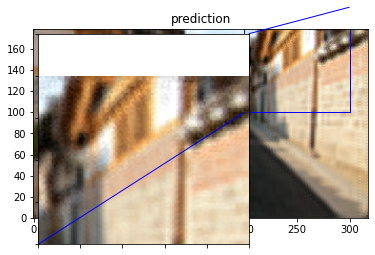

Epoch 2/50
178/178 - 14s - loss: 0.0022 - val_loss: 0.0022
Mean PSNR for epoch: 26.45
Epoch 3/50
178/178 - 14s - loss: 0.0020 - val_loss: 0.0021
Mean PSNR for epoch: 26.82
Epoch 4/50
178/178 - 13s - loss: 0.0020 - val_loss: 0.0021
Mean PSNR for epoch: 27.02
Epoch 5/50
178/178 - 13s - loss: 0.0021 - val_loss: 0.0021
Mean PSNR for epoch: 26.77
Epoch 6/50
178/178 - 14s - loss: 0.0020 - val_loss: 0.0020
Mean PSNR for epoch: 26.89
Epoch 7/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 26.76
Epoch 8/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 26.68
Epoch 9/50
178/178 - 14s - loss: 0.0020 - val_loss: 0.0020
Mean PSNR for epoch: 26.83
Epoch 10/50
178/178 - 13s - loss: 0.0020 - val_loss: 0.0020
Mean PSNR for epoch: 27.00
Epoch 11/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 26.85
Epoch 12/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.01
Epoch 13/50
178/178 - 13s - loss: 0.0019 - val_loss

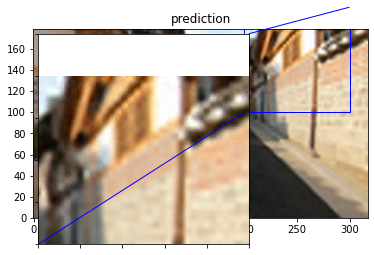

Epoch 22/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.07
Epoch 23/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.15
Epoch 24/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.07
Epoch 25/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.35
Epoch 26/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.07
Epoch 27/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.18
Epoch 28/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 26.96
Epoch 29/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.10
Epoch 30/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.00
Epoch 31/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.10
Epoch 32/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 27.03
Epoch 33/50
178/178 - 13s - loss: 0.0019 - 

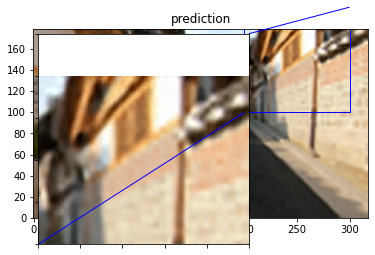

Epoch 42/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 26.86
Epoch 43/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 26.93
Epoch 44/50
178/178 - 13s - loss: 0.0018 - val_loss: 0.0020
Mean PSNR for epoch: 27.06
Epoch 45/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0020
Mean PSNR for epoch: 26.89
Epoch 46/50
178/178 - 14s - loss: 0.0018 - val_loss: 0.0019
Mean PSNR for epoch: 27.09
Epoch 47/50
178/178 - 13s - loss: 0.0018 - val_loss: 0.0019
Mean PSNR for epoch: 27.12
Epoch 48/50
178/178 - 13s - loss: 0.0019 - val_loss: 0.0021
Mean PSNR for epoch: 26.90
Epoch 49/50
178/178 - 14s - loss: 0.0019 - val_loss: 0.0019
Mean PSNR for epoch: 27.09
Epoch 50/50
178/178 - 13s - loss: 0.0018 - val_loss: 0.0019
Mean PSNR for epoch: 27.40


In [24]:
import time
start = time.time()
epochs = 50

model.compile(
    optimizer=optimizer, loss=loss_fn,)

model.fit(
    train_ds, epochs=epochs, callbacks=callbacks, validation_data=valid_ds, verbose=2
)

# The model weights (that are considered the best) are loaded into the model.
model.load_weights(checkpoint_filepath)



PSNR of low resolution image and high resolution image is 26.2181
PSNR of predict and high resolution is 27.0124


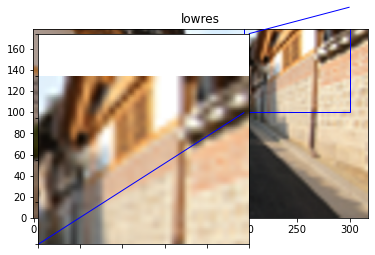

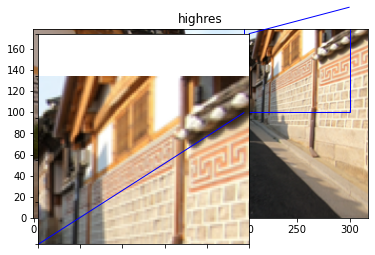

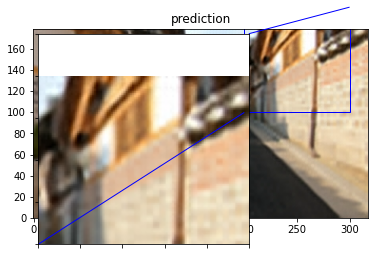

PSNR of low resolution image and high resolution image is 34.2073
PSNR of predict and high resolution is 34.7748


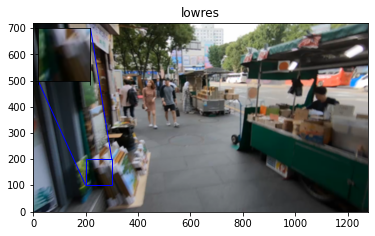

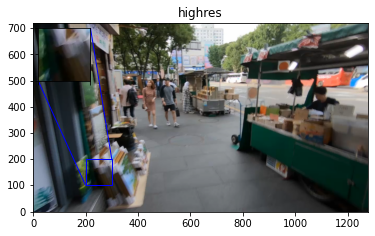

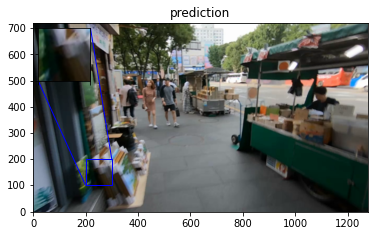

PSNR of low resolution image and high resolution image is 26.7463
PSNR of predict and high resolution is 27.5188


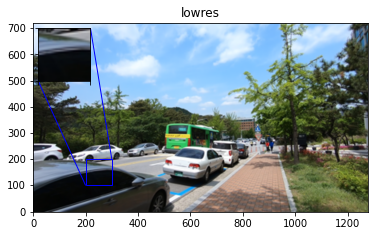

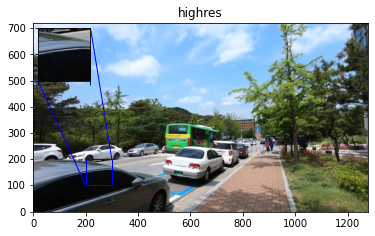

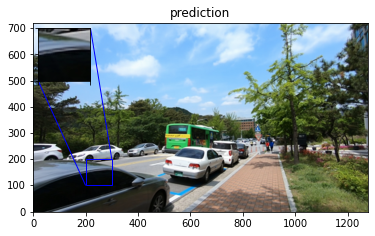

PSNR of low resolution image and high resolution image is 28.0020
PSNR of predict and high resolution is 28.9252


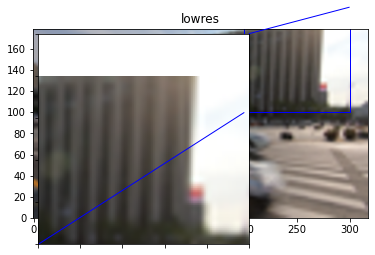

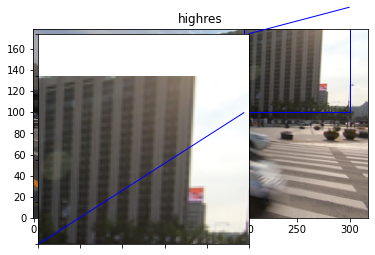

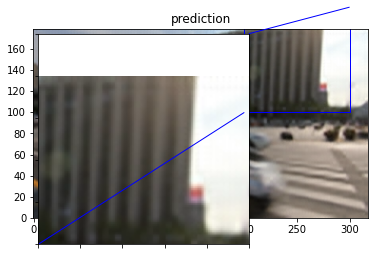

PSNR of low resolution image and high resolution image is 26.5682
PSNR of predict and high resolution is 27.3900


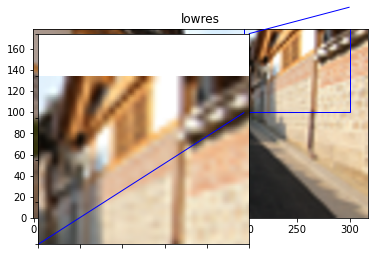

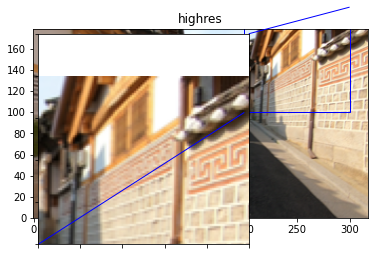

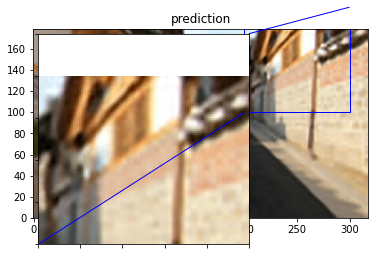

PSNR of low resolution image and high resolution image is 33.5683
PSNR of predict and high resolution is 34.1621


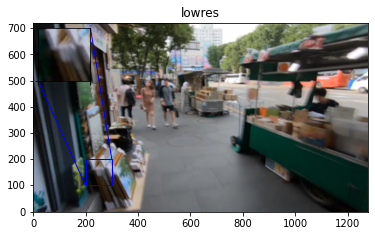

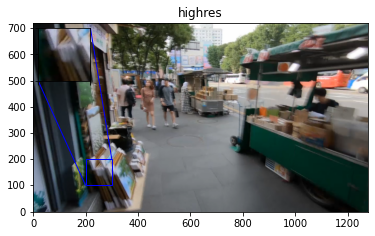

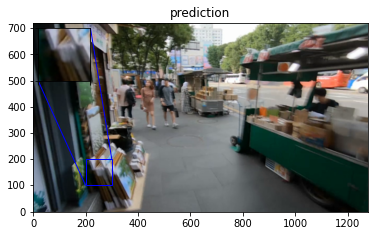

PSNR of low resolution image and high resolution image is 27.0851
PSNR of predict and high resolution is 27.8525


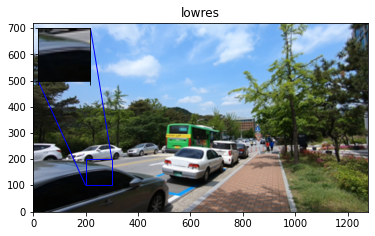

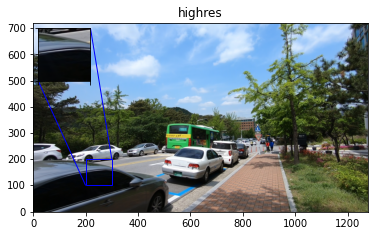

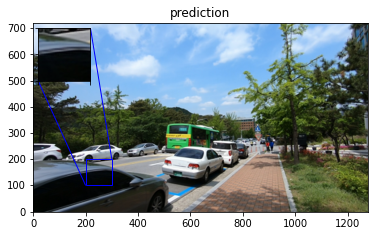

PSNR of low resolution image and high resolution image is 27.9896
PSNR of predict and high resolution is 28.9351


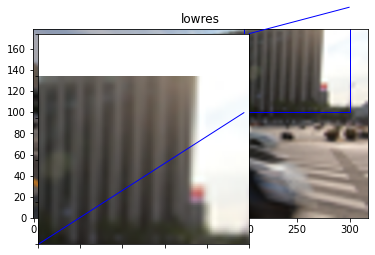

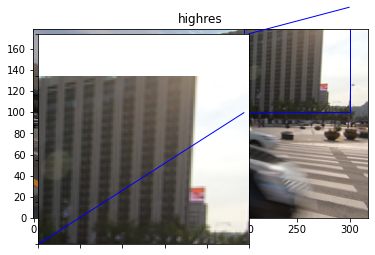

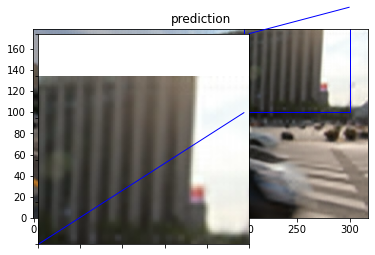

PSNR of low resolution image and high resolution image is 27.2976
PSNR of predict and high resolution is 28.2401


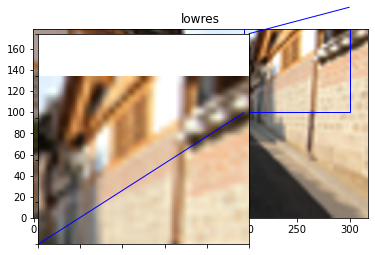

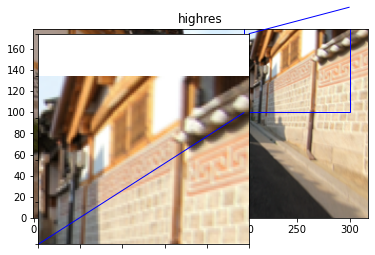

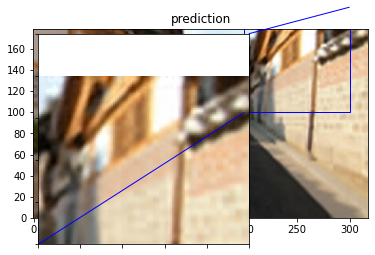

PSNR of low resolution image and high resolution image is 40.3991
PSNR of predict and high resolution is 38.9703


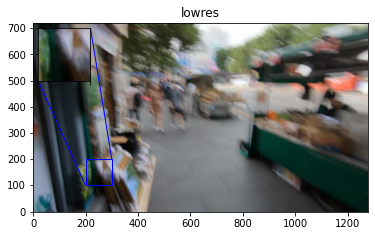

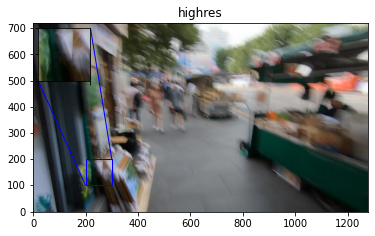

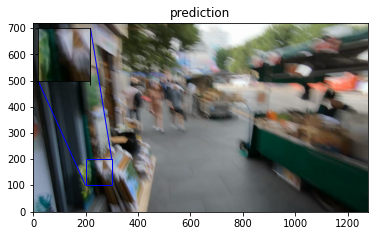

PSNR of low resolution image and high resolution image is 27.3210
PSNR of predict and high resolution is 28.0845


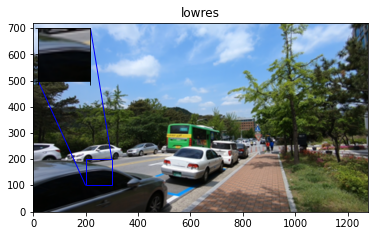

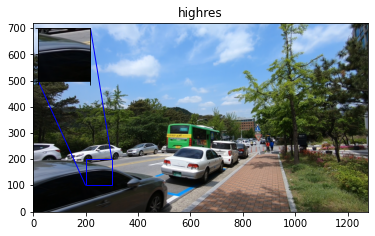

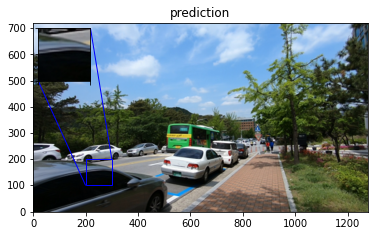

PSNR of low resolution image and high resolution image is 28.1444
PSNR of predict and high resolution is 29.0319


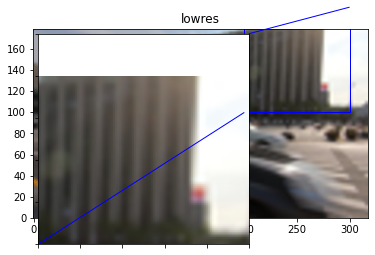

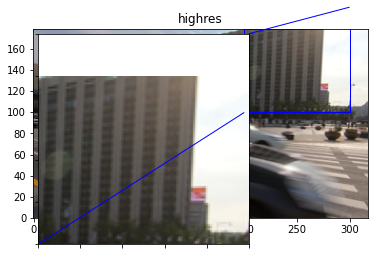

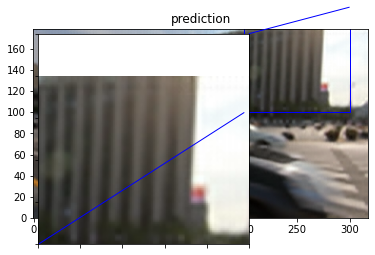

PSNR of low resolution image and high resolution image is 28.1394
PSNR of predict and high resolution is 29.0413


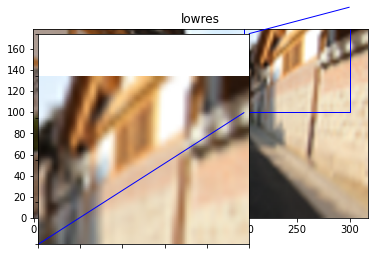

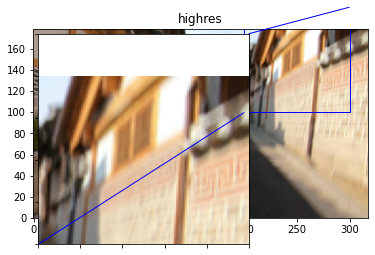

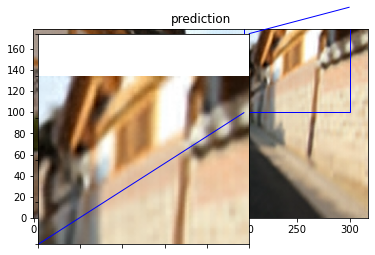

PSNR of low resolution image and high resolution image is 42.4061
PSNR of predict and high resolution is 39.8256


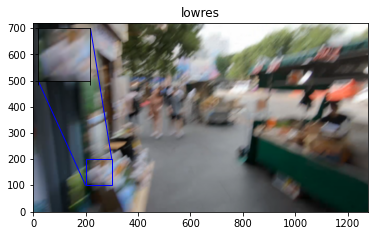

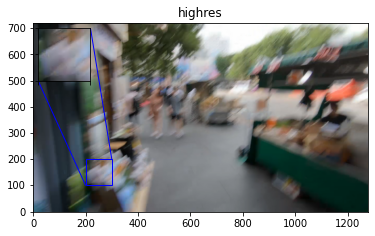

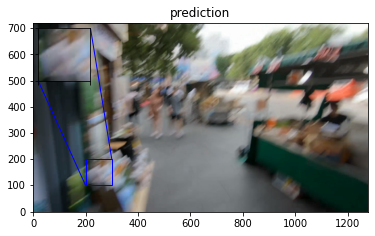

PSNR of low resolution image and high resolution image is 27.6952
PSNR of predict and high resolution is 28.4744


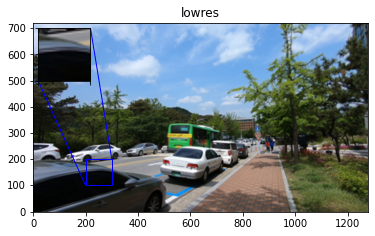

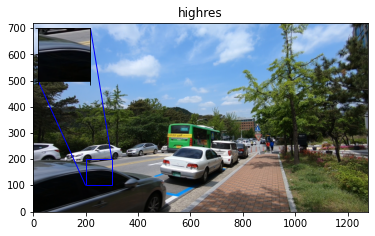

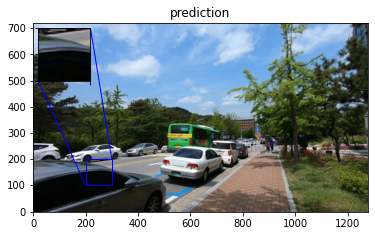

PSNR of low resolution image and high resolution image is 28.2753
PSNR of predict and high resolution is 29.1197


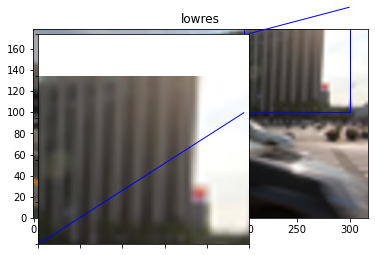

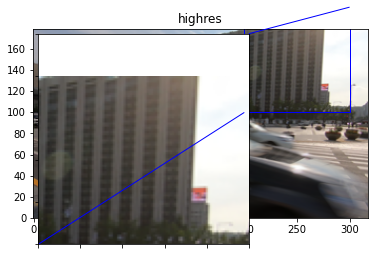

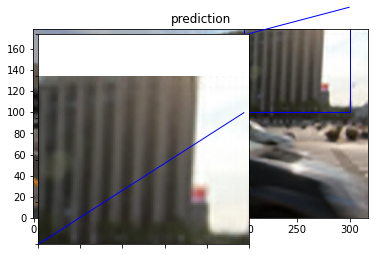

PSNR of low resolution image and high resolution image is 30.2496
PSNR of predict and high resolution is 31.1650


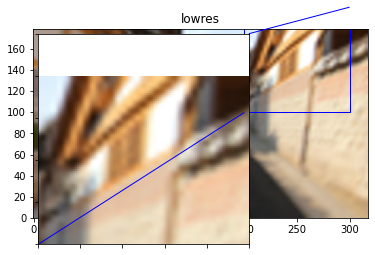

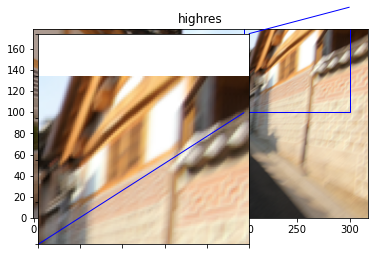

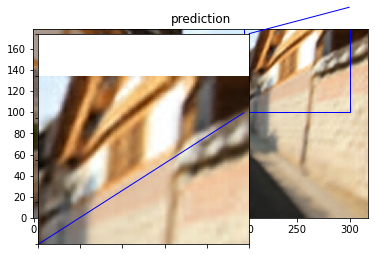

PSNR of low resolution image and high resolution image is 42.9554
PSNR of predict and high resolution is 40.1439


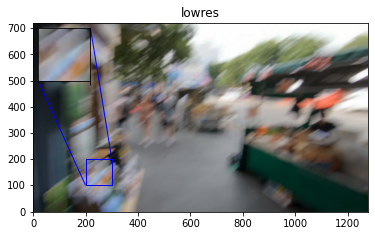

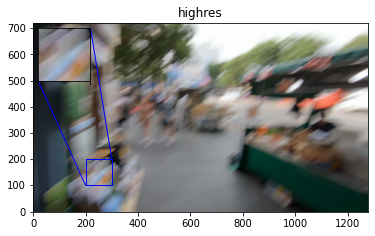

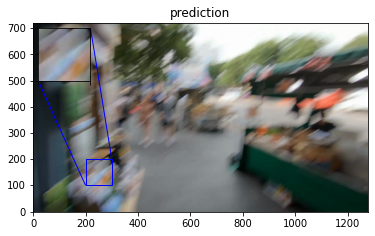

PSNR of low resolution image and high resolution image is 27.6376
PSNR of predict and high resolution is 28.3816


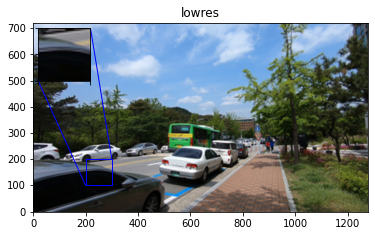

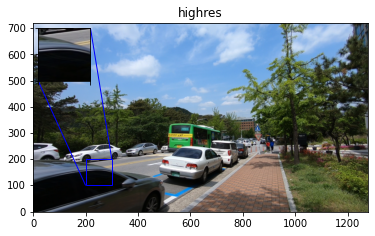

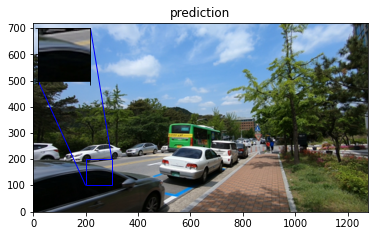

PSNR of low resolution image and high resolution image is 28.4279
PSNR of predict and high resolution is 29.2582


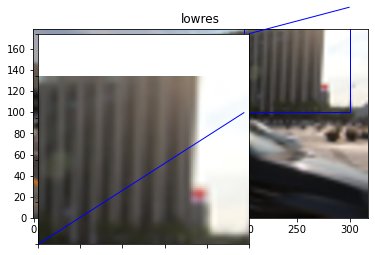

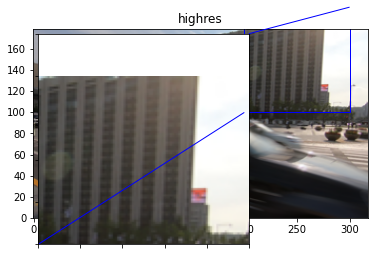

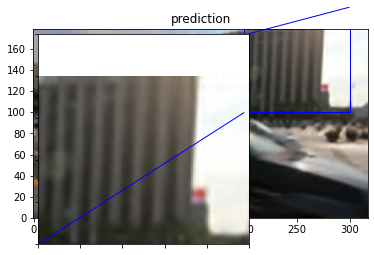

PSNR of low resolution image and high resolution image is 26.4238
PSNR of predict and high resolution is 27.4238


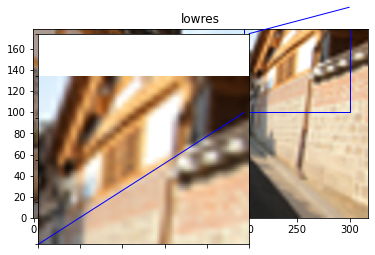

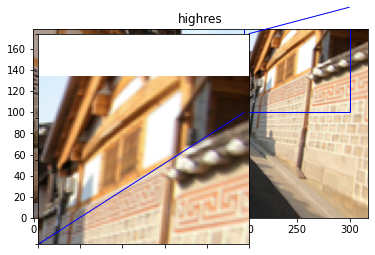

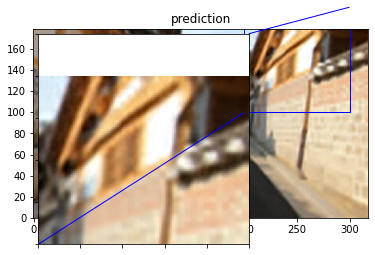

PSNR of low resolution image and high resolution image is 40.3587
PSNR of predict and high resolution is 39.0301


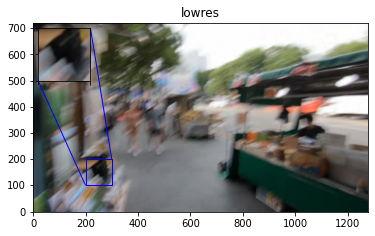

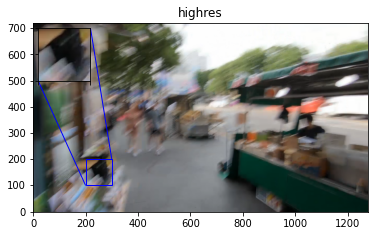

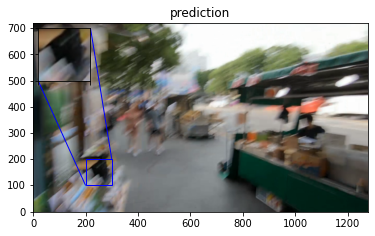

PSNR of low resolution image and high resolution image is 27.6785
PSNR of predict and high resolution is 28.4219


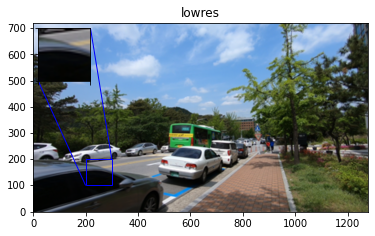

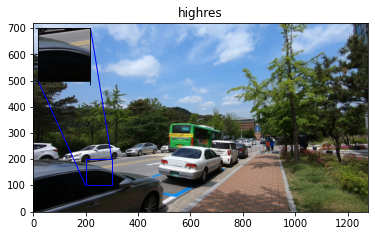

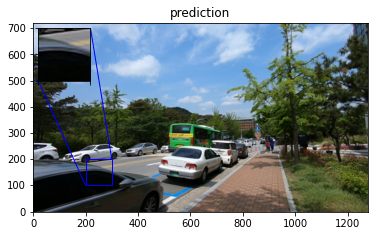

PSNR of low resolution image and high resolution image is 28.5675
PSNR of predict and high resolution is 29.3938


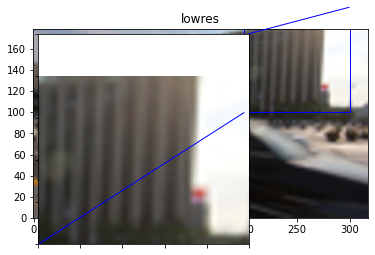

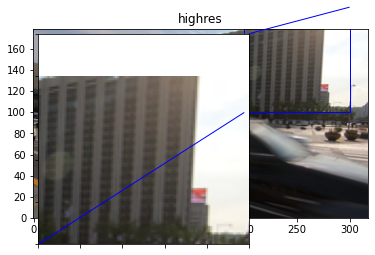

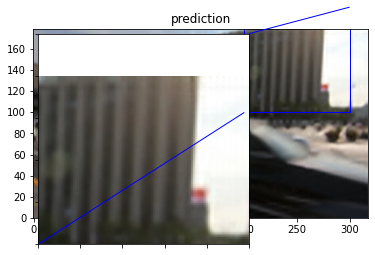

PSNR of low resolution image and high resolution image is 26.9192
PSNR of predict and high resolution is 27.9035


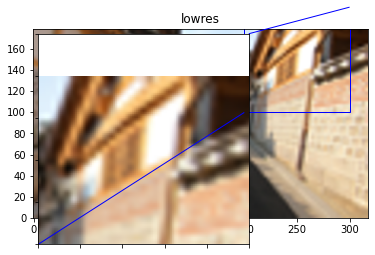

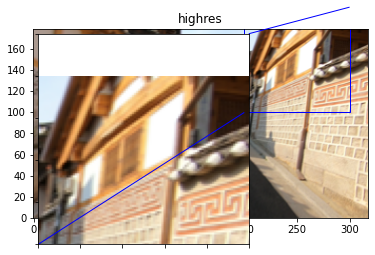

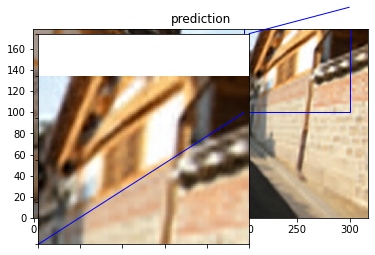

PSNR of low resolution image and high resolution image is 36.1239
PSNR of predict and high resolution is 36.3007


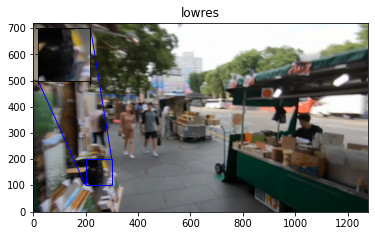

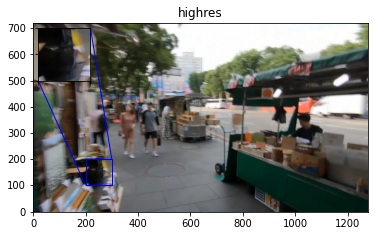

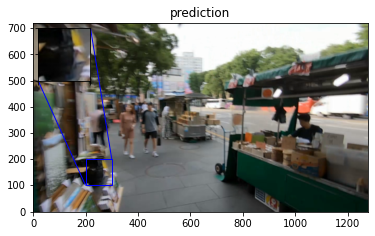

PSNR of low resolution image and high resolution image is 27.7183
PSNR of predict and high resolution is 28.4430


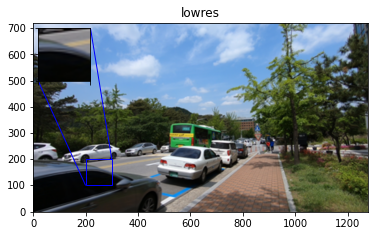

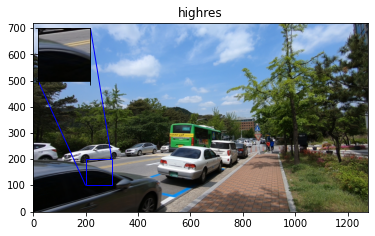

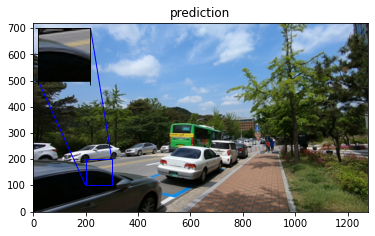

PSNR of low resolution image and high resolution image is 28.6949
PSNR of predict and high resolution is 29.5137


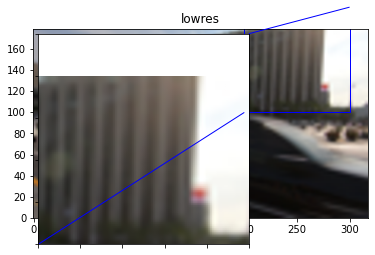

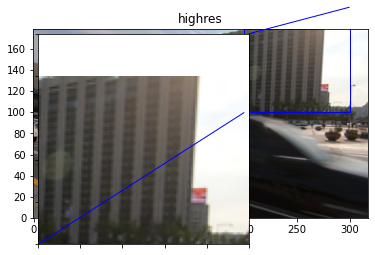

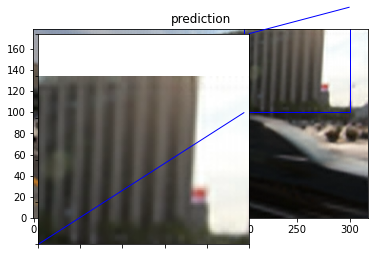

PSNR of low resolution image and high resolution image is 27.7663
PSNR of predict and high resolution is 28.7702


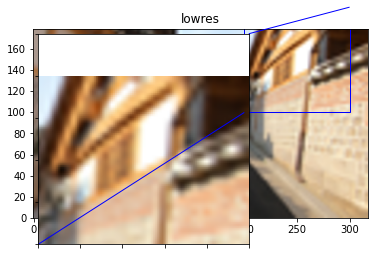

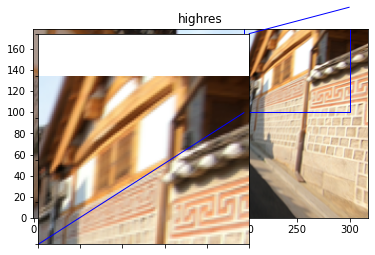

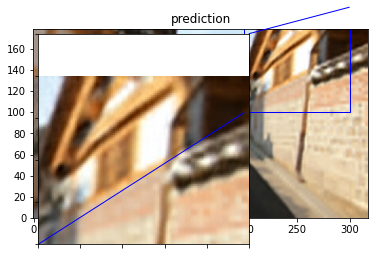

PSNR of low resolution image and high resolution image is 40.5847
PSNR of predict and high resolution is 39.1075


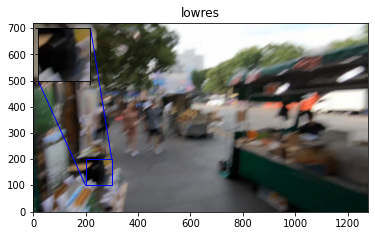

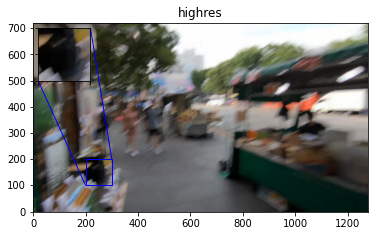

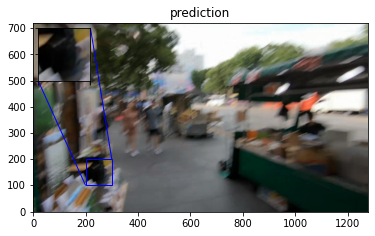

PSNR of low resolution image and high resolution image is 27.7254
PSNR of predict and high resolution is 28.4709


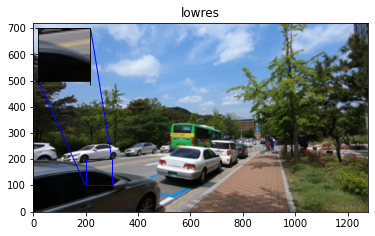

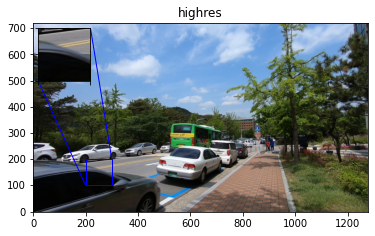

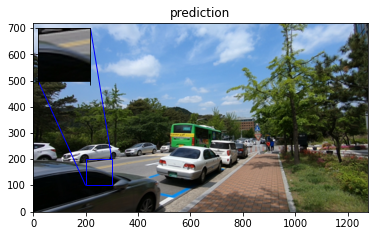

PSNR of low resolution image and high resolution image is 28.9779
PSNR of predict and high resolution is 29.8435


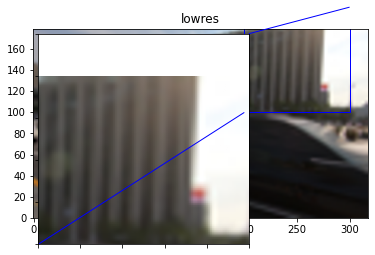

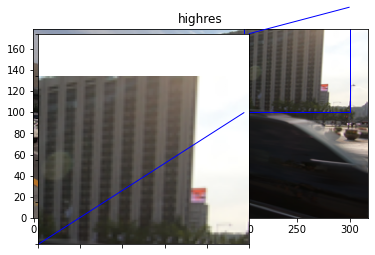

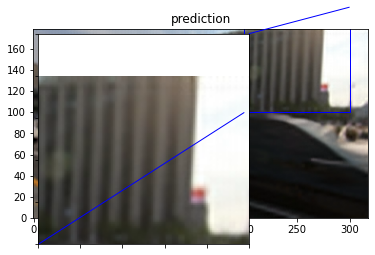

PSNR of low resolution image and high resolution image is 27.6545
PSNR of predict and high resolution is 28.7285


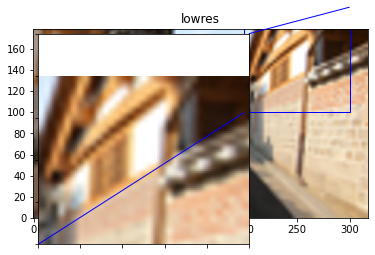

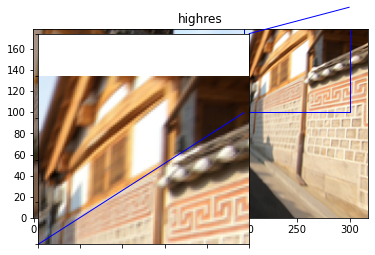

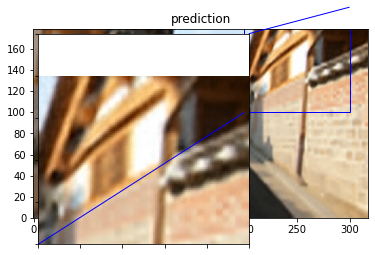

PSNR of low resolution image and high resolution image is 39.8183
PSNR of predict and high resolution is 38.8349


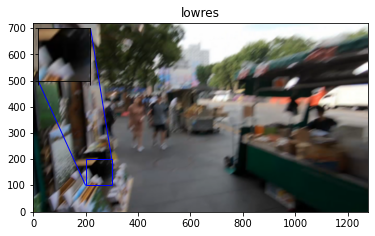

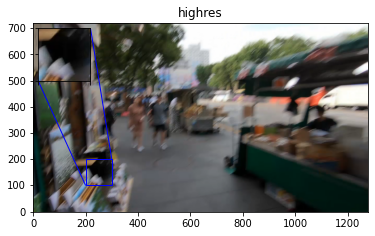

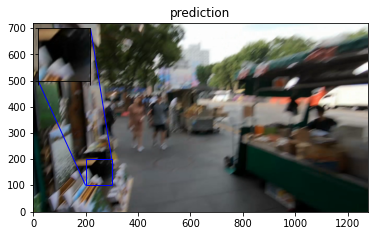

PSNR of low resolution image and high resolution image is 27.7612
PSNR of predict and high resolution is 28.5279


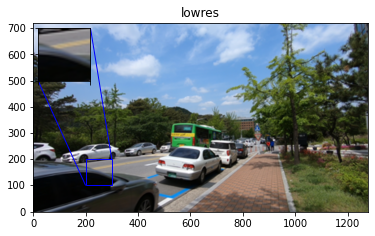

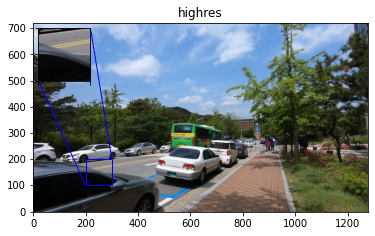

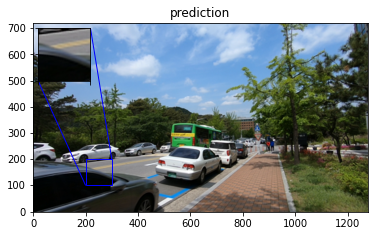

PSNR of low resolution image and high resolution image is 29.2347
PSNR of predict and high resolution is 30.1865


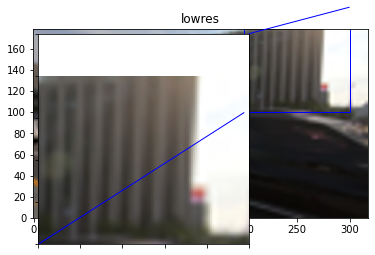

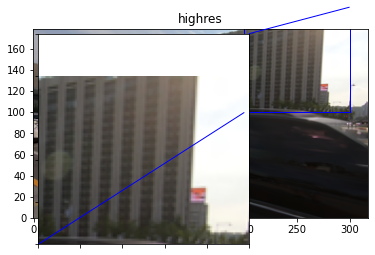

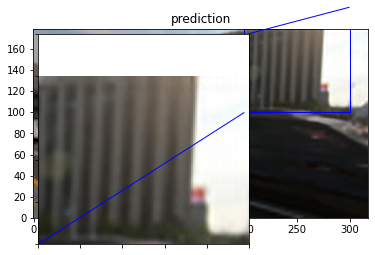

PSNR of low resolution image and high resolution image is 28.1739
PSNR of predict and high resolution is 29.0751


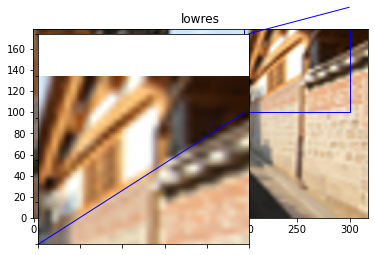

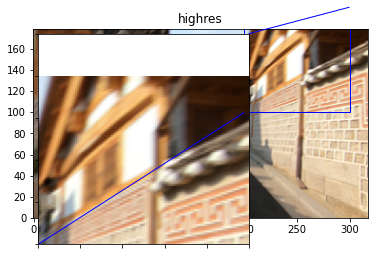

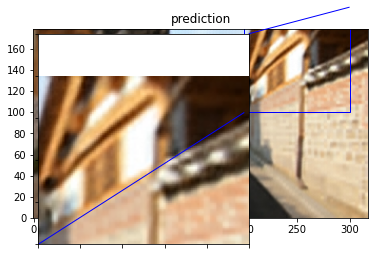

PSNR of low resolution image and high resolution image is 40.4422
PSNR of predict and high resolution is 39.1712


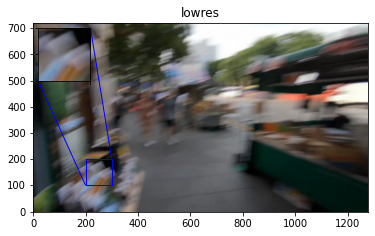

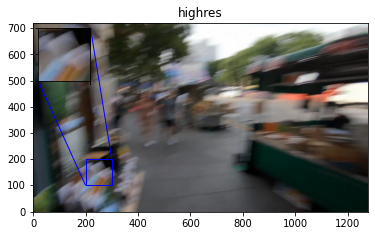

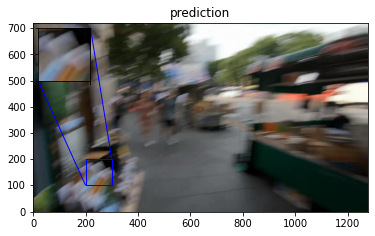

PSNR of low resolution image and high resolution image is 27.7233
PSNR of predict and high resolution is 28.4895


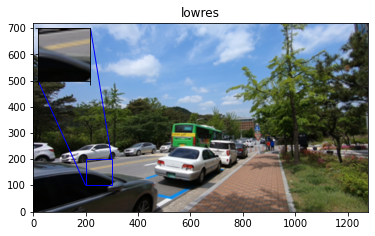

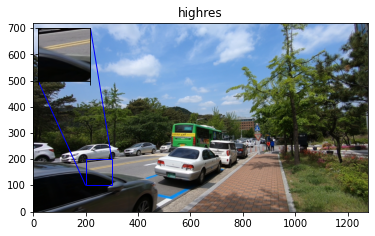

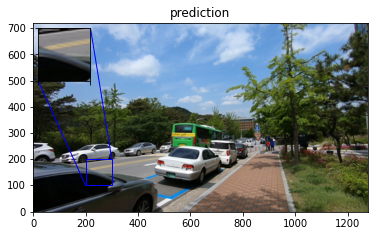

PSNR of low resolution image and high resolution image is 29.2347
PSNR of predict and high resolution is 30.2103


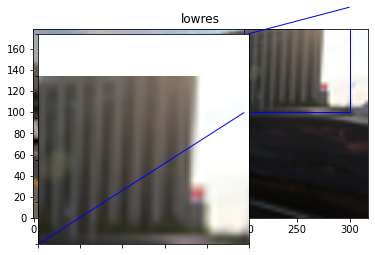

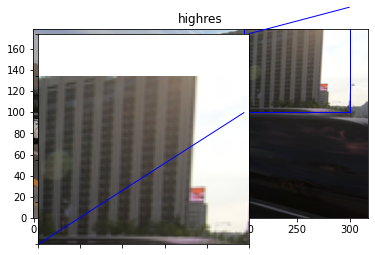

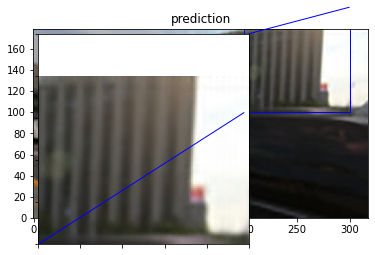

PSNR of low resolution image and high resolution image is 26.9962
PSNR of predict and high resolution is 27.9908


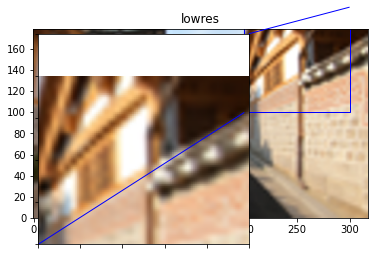

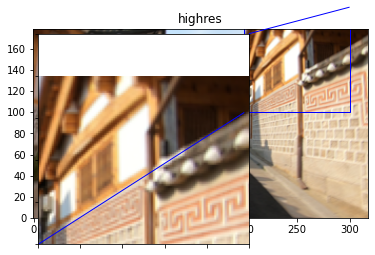

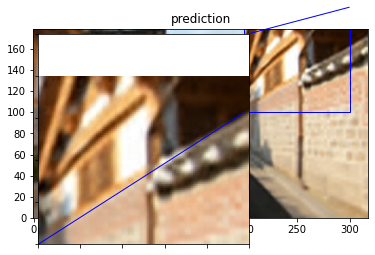

PSNR of low resolution image and high resolution image is 37.4832
PSNR of predict and high resolution is 37.2380


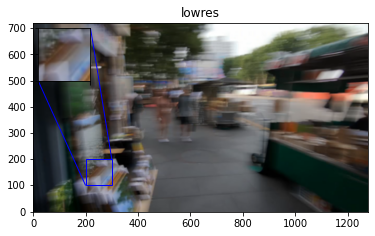

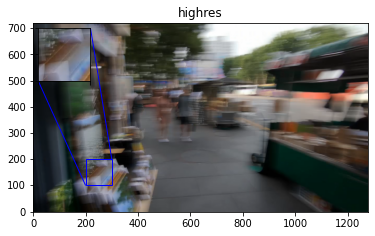

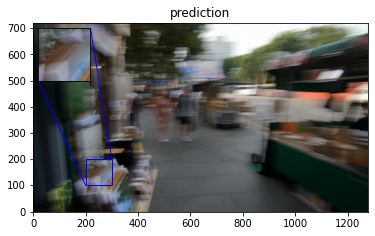

PSNR of low resolution image and high resolution image is 27.7130
PSNR of predict and high resolution is 28.4919


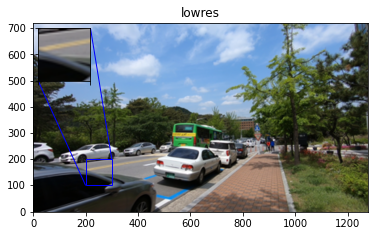

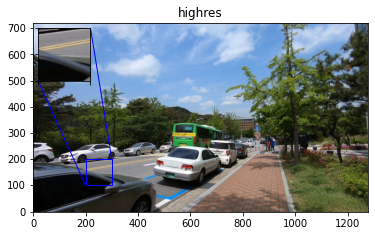

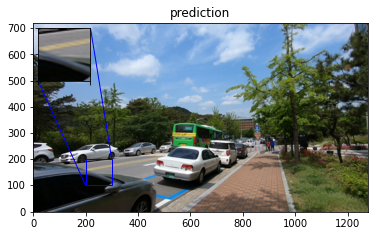

PSNR of low resolution image and high resolution image is 28.9554
PSNR of predict and high resolution is 29.7877


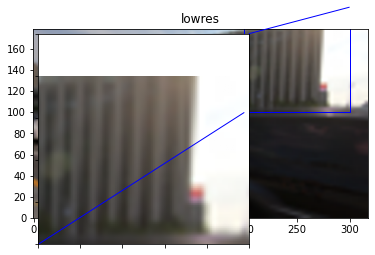

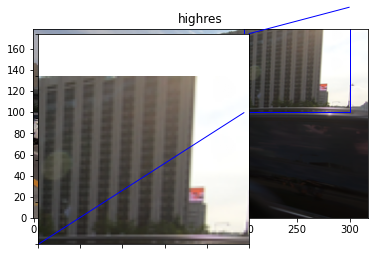

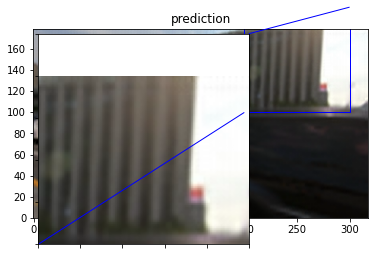

PSNR of low resolution image and high resolution image is 30.3034
PSNR of predict and high resolution is 31.0984


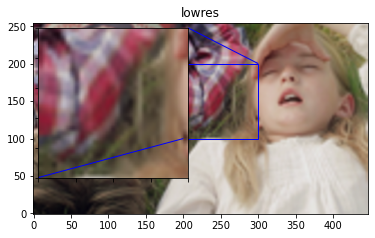

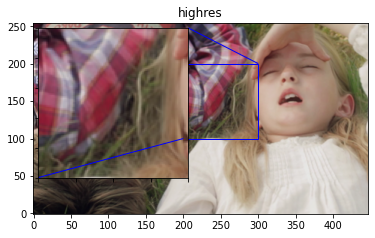

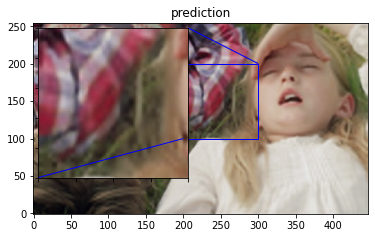

PSNR of low resolution image and high resolution image is 27.9598
PSNR of predict and high resolution is 28.8808


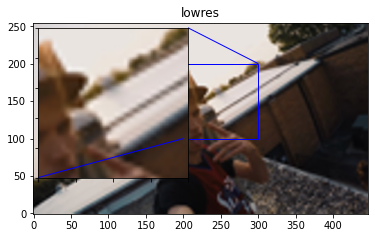

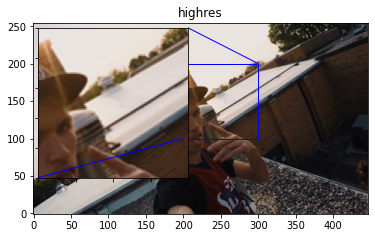

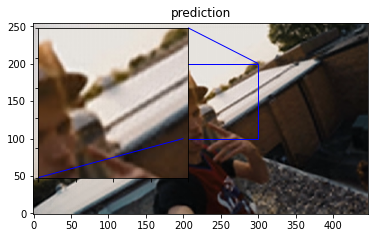

PSNR of low resolution image and high resolution image is 30.3696
PSNR of predict and high resolution is 31.1402


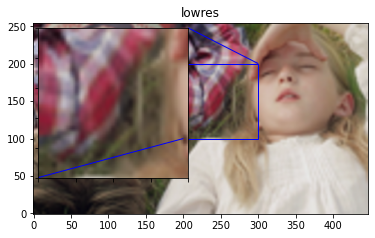

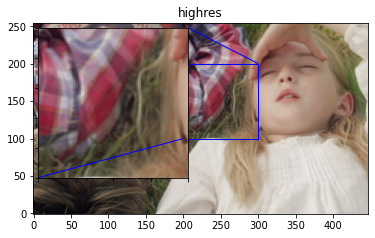

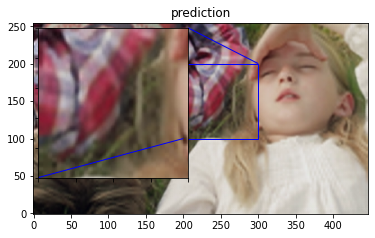

PSNR of low resolution image and high resolution image is 28.3016
PSNR of predict and high resolution is 29.2457


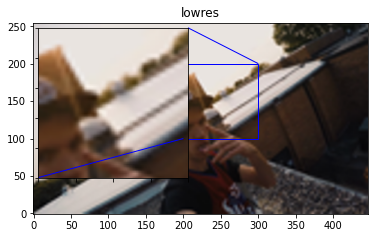

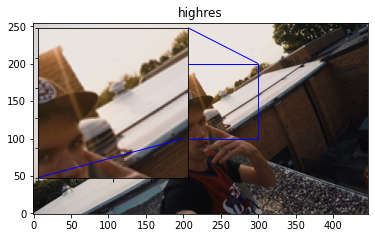

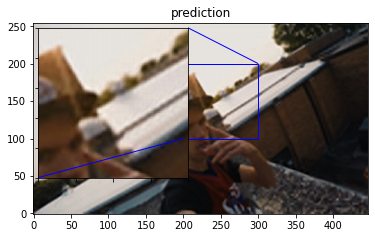

PSNR of low resolution image and high resolution image is 30.4734
PSNR of predict and high resolution is 31.2217


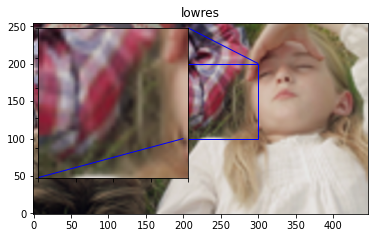

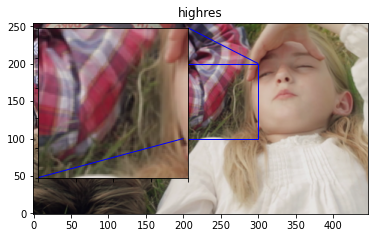

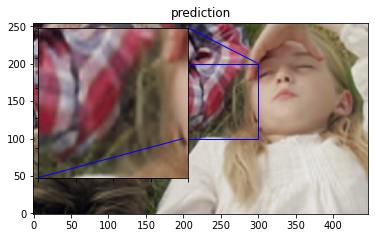

PSNR of low resolution image and high resolution image is 28.4067
PSNR of predict and high resolution is 29.4023


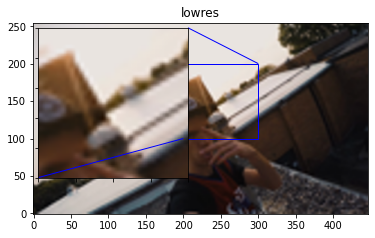

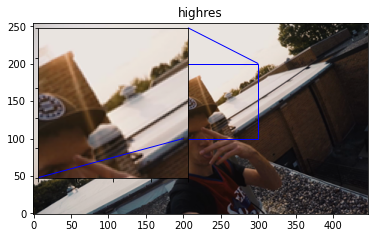

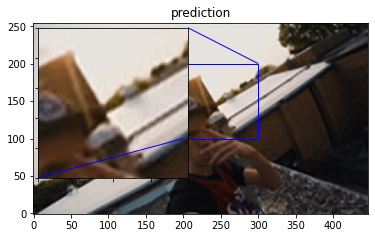

Avg. PSNR of lowres images is 152.3877
Avg. PSNR of reconstructions is 154.6652


In [25]:
total_bicubic_psnr = 0.0
total_test_psnr = 0.0

for index, test_img_path in enumerate(test_img_paths[0:50]):
    img = load_img(test_img_path)
    lowres_input = get_lowres_image(img, upscale_factor)
    w = lowres_input.size[0] * upscale_factor
    h = lowres_input.size[1] * upscale_factor
    highres_img = img.resize((w, h))
    prediction = upscale_image(model, lowres_input)
    lowres_img = lowres_input.resize((w, h))
    lowres_img_arr = img_to_array(lowres_img)
    highres_img_arr = img_to_array(highres_img)
    predict_img_arr = img_to_array(prediction)
    bicubic_psnr = tf.image.psnr(lowres_img_arr, highres_img_arr, max_val=255)
    test_psnr = tf.image.psnr(predict_img_arr, highres_img_arr, max_val=255)

    total_bicubic_psnr += bicubic_psnr
    total_test_psnr += test_psnr

    print(
        "PSNR of low resolution image and high resolution image is %.4f" % bicubic_psnr
    )
    print("PSNR of predict and high resolution is %.4f" % test_psnr)
    plot_results(lowres_img, index, "lowres")
    plot_results(highres_img, index, "highres")
    plot_results(prediction, index, "prediction")

print("Avg. PSNR of lowres images is %.4f" % (total_bicubic_psnr / 10))
print("Avg. PSNR of reconstructions is %.4f" % (total_test_psnr / 10))


In [26]:
end = time.time()
print("[INFO] inference time {:.6f} seconds".format(
	end - start))

[INFO] inference time 1314.633852 seconds
